In [19]:
!pip install transformers[torch]

In [20]:
from transformers import TrOCRProcessor, VisionEncoderDecoderModel
from PIL import Image
from IPython.display import display

In [21]:
# for handwritten images
processor = TrOCRProcessor.from_pretrained("microsoft/trocr-large-handwritten")
model = VisionEncoderDecoderModel.from_pretrained("microsoft/trocr-large-handwritten")

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
Some weights of VisionEncoderDecoderModel were not initialized from the model checkpoint at microsoft/trocr-large-handwritten and are newly initialized: ['encoder.pooler.dense.bias', 'encoder.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [22]:
def show_image(image_path):
  img = Image.open(image_path).convert('RGB')
  display(img)
  return img


def ocr_image(img):
  pixel_value = processor(images=img, return_tensors="pt").pixel_values
  generated_ids = model.generate(pixel_value)
  return processor.batch_decode(generated_ids, skip_special_tokens=True)[0]

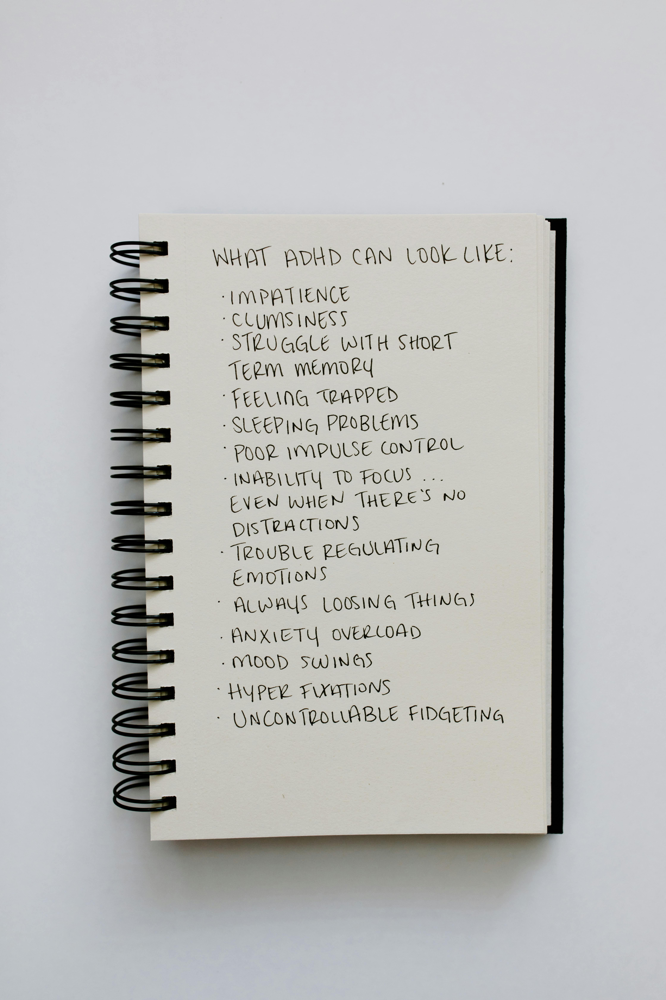

In [23]:
img = show_image('handWritten.jpg')

In [24]:
ocr_image(img) # trOCR do not work with the full images should crop it

/usr/local/lib/python3.10/dist-packages/transformers/generation/utils.py:1258: UserWarning: Using the model-agnostic default `max_length` (=20) to control the generation length. We recommend setting `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(


'1961'

In [27]:
img.size

(4480, 6720)

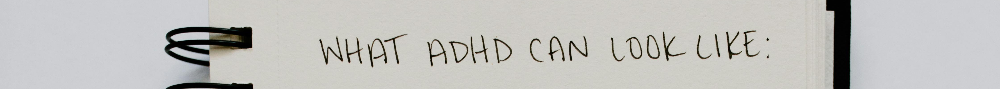

In [29]:
cropped_img1 = img.crop((0,1500,4480,1900)) # left, upper, right, lower
display(cropped_img1)

In [30]:
ocr_image(cropped_img1)

/usr/local/lib/python3.10/dist-packages/transformers/generation/utils.py:1258: UserWarning: Using the model-agnostic default `max_length` (=20) to control the generation length. We recommend setting `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(


'what ADHD can look like :'